## Analyzing the Relationship between an Individual's Body Mass Index (BMI) and Blood Glucose Levels to Determine if They Have Diabetes

### Introduction:
Diabetes refers to a disease that impacts the way the body regulates and uses glucose in the body. Glucose is a crucial source of energy for the body specifically for the brain and other muscle functions. There are multiple variables that can determine whether an individual has diabetes; these variables differ based on the type of diabetes the individual has. This data set lists the gender, age, BMI, smoking habits, blood glucose levels, if they have heart disease, and their HbA1c levels. In our analysis we will use BMI and blood glucose levels in order to determine if an individual has diabetes. High BMI is often linked to an increased risk of developing diabetes. Similarly, high levels of glucose in the blood can be an indicator of this disease. 


### Methods:
- **Explain how you will conduct either your data analysis and which variables/columns you will use.**
We will use the K Nearest Neighbor (KNN) algorithm to classify patients into categories of diabetes or no diabetes based on their BMI and blood glucose levels. We will use the following variables:

BMI: This variable represents the patient's BMI. The BMI is calculated by using the patient's weight and height with the following formula. BMI = Weight(KG) / Height(M) squared. This will be used as a predictor.

Blood Glucose Level: This variable represents the patient's blood glucose levels. The blood glucose level is the amount of glucose in the bloodstream. This is measured in mg/dL. This will be used a predictor

Diabetes: This will be our target variable that we will be classifying for. This variable represents if the patient has diabetes or not. 0 for no diabetes and 1 for diabetes.

- **Describe at least one way that you will visualize the results**
We will visualize the results by graphing the BMI on the x-axis and the Blood Glucose Levels on the y-axis. Then we will color the dots according to the patients having diabetes or not having diabetes.

### Expected outcomes and significance:

- **What do you expect to find?**
We expect that the higher the BMI and glucose blood levels an individual has, the higher risk they are to developing diabetes. This is expected because the general trend of the data is that the higher of each variable, the more likely the observation is classified to have diabetes.

- **What impact could such findings have?**
The impact of these findings can be helpful when determining diabetes in the future without rigorous testing. At this moment, individuals who are being tested for diabetes have to undergo multiple tests and cross-examination in order for a doctor to diagnose them with diabetes. With this model, we can give the individuals an idea early on in the testing journey whether or not they have diabetes. This can be done by comparing two variables in order to give the individual an accurate diagnosis early.

- **What future questions could this lead to?**
This model and these findings can lead to other models which determine with accuracy whether or not an individual has a disease. It can also lead to questions revolving which variables are better indicators of certain diseases.


## Preliminary exploratory data analysis:

In [1]:
library(tidyverse)
library(repr)
library(tidymodels)
library(readxl)
options(repr.matrix.max.rows = 6)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.3     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.4     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.0
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.5     ✔ rsample      1.2.0
✔ dials        1.2.0     ✔ tune         1.1.2
✔ infer        1.0.5     ✔ workflows    1.1.3
✔ modeldata    1.2.0     ✔ workflowsets 1.0.1
✔ parsnip      1.1.1     ✔ yardstick    1.2.0
✔ recipes      1.0.8     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filt

In [2]:
diabetes_data <- read_csv("https://raw.githubusercontent.com/YunYun5/DSCI100-Project/main/data/diabetes.csv")

var1 = "bmi"
var2 = "blood_glucose_level"
spec = "diabetes"
filtered_diabetes <- diabetes_data |>
    select(var1, var2, spec)|>
    mutate(diabetes = as_factor(diabetes))

diabetes_data
filtered_diabetes

Rows: 100000 Columns: 9
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (2): gender, smoking_history
dbl (7): age, hypertension, heart_disease, bmi, HbA1c_level, blood_glucose_l...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.
Warning message:
“Using an external vector in selections was deprecated in tidyselect 1.1.0.
ℹ Please use `all_of()` or `any_of()` instead.
  # Was:
  data %>% select(var1)

  # Now:
  data %>% select(all_of(var1))

See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.”
Warning message:
“Using an external vector in selections was deprecated in tidyselect 1.1.0.
ℹ Please use `all_of()` or `any_of()` instead.
  # Was:
  data %>% select(var2)

  # Now:
  data %>% select(all_of(var2))

See <https://tidyselect.r-lib.org/reference/faq-external-vector.html>.”
Warning message:
“Using an external 

gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
<chr>,<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
Female,80,0,1,never,25.19,6.6,140,0
Female,54,0,0,No Info,27.32,6.6,80,0
Male,28,0,0,never,27.32,5.7,158,0
⋮,⋮,⋮,⋮,⋮,⋮,⋮,⋮,⋮
Male,66,0,0,former,27.83,5.7,155,0
Female,24,0,0,never,35.42,4.0,100,0
Female,57,0,0,current,22.43,6.6,90,0


bmi,blood_glucose_level,diabetes
<dbl>,<dbl>,<fct>
25.19,140,0
27.32,80,0
27.32,158,0
⋮,⋮,⋮
27.83,155,0
35.42,100,0
22.43,90,0


In [3]:
diabetes_split <- initial_split(filtered_diabetes, prop = 0.75, strata = diabetes)  
diabetes_train <- training(diabetes_split)   
diabetes_test <- testing(diabetes_split)



knn_spec <- nearest_neighbor(weight_func =  "rectangular", neighbors = 7) |>
      set_engine("kknn") |>
      set_mode("classification")

In [4]:
# Training data table
diabetes_train

bmi,blood_glucose_level,diabetes
<dbl>,<dbl>,<fct>
25.19,140,0
27.32,80,0
27.32,158,0
⋮,⋮,⋮
27.83,155,0
35.42,100,0
22.43,90,0


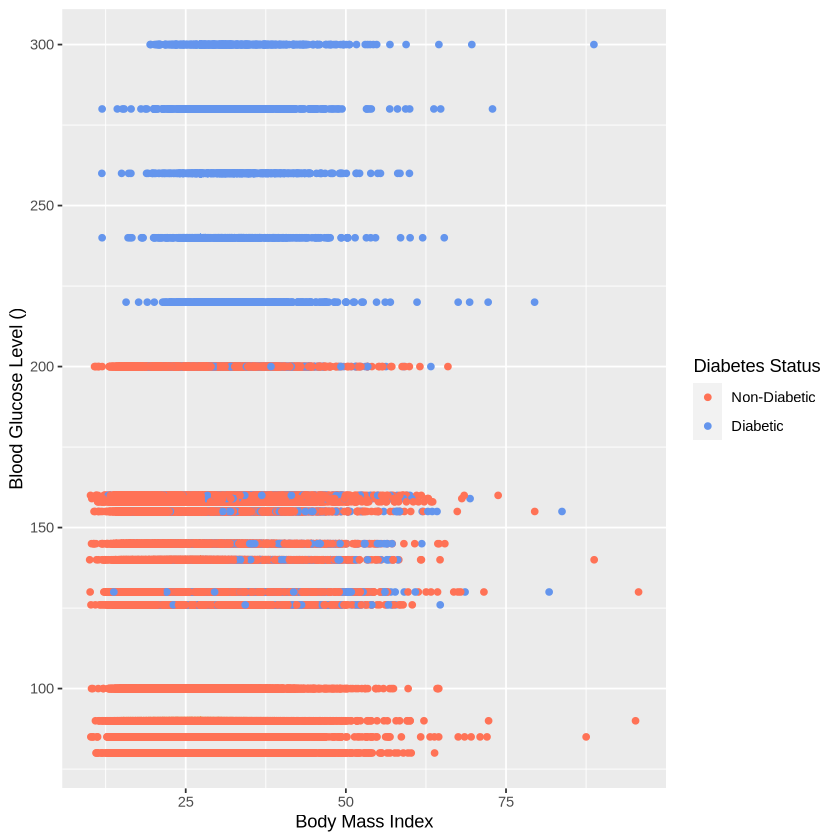

In [5]:
# Training data graph

diabetes_graph <- diabetes_train |>  
    ggplot(aes(x= bmi, 
               y= blood_glucose_level, 
               colour = diabetes)) +
        geom_point() +
        labs(x = "Body Mass Index",
             y = "Blood Glucose Level ()",
            colour = "Diabetes Status") +
            scale_colour_manual(values = c("coral1", "cornflowerblue"),
            labels = c("Non-Diabetic", "Diabetic"))

diabetes_graph